In [295]:
import warnings
warnings.simplefilter(action='ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso, Ridge, LogisticRegression
from sklearn.ensemble import GradientBoostingClassifier
import statsmodels.formula.api as smf
import seaborn as sns
import json
import heapq
import random

from collections import OrderedDict

def unique_ordered_list(input_list):
    # Use an OrderedDict to maintain order and eliminate duplicates
    unique_dict = OrderedDict.fromkeys(input_list)

    # Get the keys (unique values) from the OrderedDict
    unique_list = list(unique_dict.keys())

    return unique_list

import warnings
from sklearn.exceptions import ConvergenceWarning
warnings.filterwarnings("ignore", category=ConvergenceWarning)


def sim(trck,times,distance,dogs,lower_mult,upper_mult,lower_lim,upper_lim,clear_fave,BSP,few_dogs,use_straight_preds,use_320_preds,use_395_preds,use_520_preds,use_traralgon_preds):
    tracks=[trck]

    under_3=False
    for track in tracks:
        if few_dogs == False:
            data=pd.read_csv('class4/'+track+'.csv')
        
        if few_dogs == True:
            data=pd.read_csv('class3/'+track+'.csv')
        
        overall=[]
        for dist in data['Distance'].unique():
            if dist==distance:
                data2=data[data['Distance']==dist]
        #             print(data2.shape[0])
                if(data2.shape[0]>1000):
                    
                    if(use_straight_preds):
                        preds = ['split_z_avg', 'last_5_avg', 'at_cas_dist_time', 'mean_place', 'pir3', 'at_cas_perc', 'collision', 'i1', 'mean_in_race_pos']
                    
                    if(use_320_preds):
                        preds = ['faster_inside','i2','i1','split_z_avg','last_5_avg']
                    
                    if(use_395_preds):
                        preds = ['at_cas_dist_time_avg', 'faster_inside', 'i2', 'i1', 'split_z_avg', 'last_5_avg', 'mean_place', 'time_z_avg']
                    
                    if(use_520_preds):
                        preds = ['at_cas_dist_time_avg', 'faster_inside', 'i2', 'i1', 'split_z_avg', 'last_5_avg', 'mean_place', 'at_cas_perc', 'in_form', 'mean_in_race_pos', 'last_5_avg']
                        
                    if(use_traralgon_preds):
                        preds = ['ctime_z_avg','last_5_avg']
                    
                    data2=data2.dropna(subset = preds)

                    races= data2['RaceId'].unique()

                    if few_dogs == False:
                        invalid = pd.read_csv('Invalid/Invalid_'+track+'.csv')
                        
                    if few_dogs == True:
                        invalid = pd.read_csv('Invalid3/Invalid'+track+'.csv')
                        
                    invalid = list(invalid['Invalid'])
    #                 print(preds)
    
                    mod = LogisticRegression(random_state=42,max_iter=2000).fit(data2[preds], data2['Win'])
                    #mod = mod_straight

                    wins=0
                    losses=0
                    money=0
                    randmoney=0
                    betsize=1
                    
                    data3 = data2.dropna(subset=['price'])

                    ls = list(data3['RaceId'])
                    unique_ordered_lista = unique_ordered_list(ls)

                    for raceid in unique_ordered_lista:
                        if data3[data3['RaceId']==raceid].shape[0] in dogs and raceid not in invalid:                                      
                            race = data3[data3['RaceId']==raceid]
                            race=race.sort_values(by='RunTime')
                            race=race.reset_index()

                            predicted_times = mod.predict_proba(race[preds])
                            predicted_times = np.transpose(predicted_times)[1]
                            predicted_times = predicted_times/sum(predicted_times)
                            our_prices=1/(predicted_times)

                            if BSP==True:
                                prices = list(race['BSP'])
                            if BSP==False:
                                prices = list(race['price'])

                            #print(race)
                            #print(race['Date'][1])
#                             if race['Date'][1] == '2023-02-12':
#                                 print(race)
#                                 print(our_prices)
#                                 print(prices)

                            to_bet_on = np.argmin(our_prices)
                            our_price = our_prices[to_bet_on]
                            their_price = prices[to_bet_on]
                            their_favourite = np.argmin(prices)
                            their_favourite_price = prices[their_favourite]
                            our_take = our_prices[their_favourite]
                            our_prices1 = sorted(our_prices)
                            our_take1 = our_prices1.index(our_take)

                            our_prices1 = list(our_prices.copy())
                            our_prices1.remove(our_price)
                            to_bet_on1 = np.argmin(our_prices1)
                            our_price1 = our_prices1[to_bet_on1] 



                            if our_price1-our_price>1.3:
                                clear_fav = True
                            else:
                                clear_fav = False

#                             if raceid==877730702:
#                                 data3[data3['RaceId']==877730702].to_csv('eeee.csv')


                            if (their_price/our_price>lower_mult and their_price/our_price<upper_mult and their_price>lower_lim and their_price<upper_lim and clear_fav == clear_fave):
#                                 if their_favourite != to_bet_on and their_price<3:
#                                                     rand = random.randint(0, 4)
#                                                     their_price_rand = prices[rand]

#                                                     while their_price_rand > 4.5:
#                                                         rand = random.randint(0, 7)
#                                                         their_price_rand = prices[rand]

#                                                     if(rand==0):
#                                                         randmoney+=(their_price_rand-1)*betsize
#                                                     else:
#                                                         randmoney-=betsize

                                if(to_bet_on==0):
                                    if BSP == True:
                                        money+=(their_price-1)*betsize*0.75
                                        wins+=1
                                    else:
                                        money+=(their_price-1)*betsize
                                        wins+=1


#                                     race = race[race['Place']==to_bet_on+1]
#                                     if int(race['i1']) == 0 and int(race['i2']) == 0:
#                                         print('outside')
#                                     if int(race['i1']) == 1:
#                                         print('inside')
#                                     if int(race['i2']) == 1:
#                                         print('middle')
                                    
                                    #print(money)
                                    #print(their_price)
                                    #print('---')
                                    #print(our_price)
                                    #print(race['Date'][1])
                                    #print(our_prices)
                                    #print(our_price)
                                    #print(prices)
                                    #print('win')

#                                     print('---')
#                                     print(our_price)
#                                     print(our_prices[their_favourite])
#                                     print('---')
                                
                                else:
                                    money-=betsize
                                    losses+=1
                                    
#                                     race = race[race['Place']==to_bet_on+1]
#                                     if int(race['i1']) == 0 and int(race['i2']) == 0:
#                                         print('outside')
#                                     if int(race['i1']) == 1:
#                                         print('inside')
#                                     if int(race['i2']) == 1:
#                                         print('middle')
                                    
                                    #print(race[['Place']])
                                    #print(money)
                                    #print(our_price)
                                    #print(race['Date'][1])
                                    #print(raceid)
                                    #print(their_price)
                                    #print(our_prices)
                                    #print(prices)
                                    #print('loss')


                    bets = wins+losses

                    if(bets!=0):
                        invested = bets*betsize
                        roi=100*(money/invested)
                        win_rate = wins/(wins+losses)


                    else:
                        invested=0
                        roi=0
                        win_rate = 0

                    res=[round(roi),round(win_rate,2),bets]
                    #res=[round(roi),round(win_rate,2),bets,'            ',randmoney]
                    


            #df = pd.DataFrame(overall)
            #df.columns=['track','dist','strat','max-size','multiplier','roi','winrate','bets']
    
    return res
        
        

In [286]:
#sim(trck,times,distance,dogs,lower_mult,upper_mult,lower_lim,upper_lim,clear_fav,use_bsp,use_straight_preds,use_320_preeds,use_395_preds,use_520_preds,use_traralgon)

sim('hobart',False,340,[7,8],   0.1,9,   2.5,4.5,   False,False,False,   False,True,False,False,False)


[56, 0.48, 23]

#### Headspace
1. You're at your best when you don't care about the money
2. I reckon you're trying to play the market not do anything that technical

# Tips
1. use cross validation
2. 7,8 thing is at least for traralg
3. gotta be sharp as you start, computer's fucked
4. lay bets gotta be on their way out?
5. do bets each morning and through the day think of it with interest rather than obsession
6. must'nt be too good to be true - This was probably recency thing
7. must be a late buy
8. maybe that track has to be on a hot streak, or 'SOMETHING's UP' e.g. traralgon

# Ideas
1. time series of wins and losses
2. few dog races
3. test for range movement 

In [374]:
'''
'albion park',False,331,[7,8],   0.1,9,   2.49,2.91,   True,False,False,   False,True,False,False,False
'albion park',False,395,[7,8],   0.1,9,   1.79,2.11,   True,False,False,   False,True,False,False,False
'albion park',False,520,[7,8],   0.1,9,   1.89,2.31,   True,False,False,   False,False,False,True,False
'ballarat',False,390,[7,8],   0.1,9,   2.89,3.31,   True,False,False,   False,True,False,False,False
'bendigo',False,425,[7,8],   0.1,9,   2.49,2.91,   True,False,False,   False,True,False,False,False
'bundaberg',False,460,[7,8],   0.1,9,   2,3,   True,False,False,   False,False,False,True,False
'bundaberg',False,460,[7,8],   0.1,9,   2,3,   False,False,False,   False,False,False,True,False
'cannington',False,275,[7,8],   0.1,9,   2.1,2.7,   True,False,False,   True,False,False,False,False
'cannington',False,380,[7,8],   0.1,9,   2.09,2.51,   True,False,False,   False,True,False,False,False
'capalaba',False,366,[7,8],   0.1,9,   2.49,3.21,   False,False,False,   True,False,False,False,False
'casino',False,411,[7,8],   0.1,9,   2.59,3.11,   True,False,False,   False,True,False,False,False
'dapto',False,297,[7,8],   0.1,9,   2,2.71,   True,False,False,   True,False,False,False,False
'darwin',False,383,[7,8],   0.1,9,   1.6,2.4,   True,False,False,   False,True,False,False,False
'gawler',False,400,[7,8],   0.1,9,   2.3,3,   True,False,False,   False,True,False,False,False
'geelong',False,400,[7,8],   0.1,9,   2.1,2.51,   True,False,False,   False,True,False,False,False
lay----'gosford',False,388,[7,8],   0.1,9,   1.89,2.41,   True,False,False,   False,True,False,False,False
lay----'goulburn',False,350,[7,8],   0.1,9,   1.79,2.21,   True,False,False,   False,True,False,False,False
'grafton',False,350,[7,8],   0.1,9,    2.19,2.7,   True,False,False,   False,True,False,False,False
lay----'horsham',False,410,[7,8],   0.1,9,   1.79,2.21,   True,False,False,   False,True,False,False,False
'ipswich',False,288,[7,8],   0.1,9,   1.79,2.11,   True,False,False,   False,True,False,False,False
'launceston',False,515,[7,8],   0.1,9,   1.99,2.71,   True,False,False,   False,False,False,True,False
'maitland',False,400,[7,8],   0.1,9,   1.6,2.7,   True,False,False,   False,True,False,False,False
'mount gambier',False,400,[7,8],   0.1,9,   1,2.8,   True,False,False,   False,True,False,False,False
'murray bridge',False,300,[7,8],   0.1,9,   1,4,   True,False,False,   True,False,False,False,False
'nowra',False,365,[7,8],   0.1,9,   2.39,3.31,   True,False,False,   False,True,False,False,False
lay----'richmond',False,320,[7,8],   0.1,9,   1.69,2.21,   True,False,False,   True,False,False,False,False
'richmond',False,401,[7,8],   0.1,9,   1.69,2.11,   True,False,False,   False,True,False,False,False
'rockhampton',False,407,[7,8],   0.1,9,   1.5,2.21,   True,False,False,   False,True,False,False,False
'sandown park',False,515,[7,8],   0.1,9,    2.39,2.91,   True,False,False,   False,True,False,False,False
'shepparton',False,390,[7,8],   0.1,9,   1.7,2.7,   False,False,False,   False,True,False,False,False
'shepparton',False,450,[7,8],   0.1,9,   1,1.5,   True,False,False,   False,True,False,False,False
'the meadows',False,525,[7,8],   0.1,9,   3,3.6,   True,False,False,   False,False,False,True,False
'townsville',False,380,[7,8],   0.1,9,   3.09,3.91,   True,False,False,   False,True,False,False,False
'traralgon',False,350,[8],   0.1,45,   1,3,   False,False,False,   False,False,False,False,True
'traralgon',False,350,[8],   0.1,9,   2.49,3.51,   True,False,False,   False,False,False,False,True
'traralgon',False,395,[8],   0.1,45,   2.99,3.31,   False,False,False,   False,False,False,False,True
'traralgon',False,450,[8],   0.1,45,   1,2.5,   True,False,False,   False,False,False,False,True
'warragul',False,400,[7,8],   0.1,9,   2,2.6,   True,False,False,   False,True,False,False,False
'wentworth park',False,520,[7,8],   0.1,9,   2.9,3.4,   True,False,False,   False,False,False,True,False

NOT
-angle park
-murray bridge


$4,600
'''

"\n'albion park',False,331,[7,8],   0.1,9,   2.49,2.91,   True,False,False,   False,True,False,False,False\n'albion park',False,395,[7,8],   0.1,9,   1.79,2.11,   True,False,False,   False,True,False,False,False\n'albion park',False,520,[7,8],   0.1,9,   1.89,2.31,   True,False,False,   False,False,False,True,False\n'ballarat',False,390,[7,8],   0.1,9,   2.89,3.31,   True,False,False,   False,True,False,False,False\n'bendigo',False,425,[7,8],   0.1,9,   2.49,2.91,   True,False,False,   False,True,False,False,False\n'bundaberg',False,460,[7,8],   0.1,9,   2,3,   True,False,False,   False,False,False,True,False\n'bundaberg',False,460,[7,8],   0.1,9,   2,3,   False,False,False,   False,False,False,True,False\n'cannington',False,275,[7,8],   0.1,9,   2.1,2.7,   True,False,False,   True,False,False,False,False\n'cannington',False,380,[7,8],   0.1,9,   2.09,2.51,   True,False,False,   False,True,False,False,False\n'capalaba',False,366,[7,8],   0.1,9,    2.19,2.61,   True,False,False,   False

In [474]:
'''
-maitland
-mount gambier
-warrnambool
-goulburn
-warragul
-geelong
-wentworth park
-angle park
-the gardens
-cannington
-the meadows
-ipswich
-capalaba
-darwin
-sandown park
-albion park
-richmond
-traralgon
-gunnedah
-geelong
-shepparton
-maitland
-launceston
-nowra
-murray bridge
-horsham
-townsville
-gosford
-grafton
-rockhampton
-ballarat
'''

'\n-maitland\n-mount gambier\n-warrnambool\n-goulburn\n-warragul\n-geelong\n-wentworth park\n-angle park\n-the gardens\n-cannington\n-the meadows\n-ipswich\n-capalaba\n-darwin\n-sandown park\n-albion park\n-richmond\n-traralgon\n-gunnedah\n-geelong\n-shepparton\n-maitland\n-launceston\n-nowra\n'

{1.5: 13, 1.6: 10, 1.7: 10}


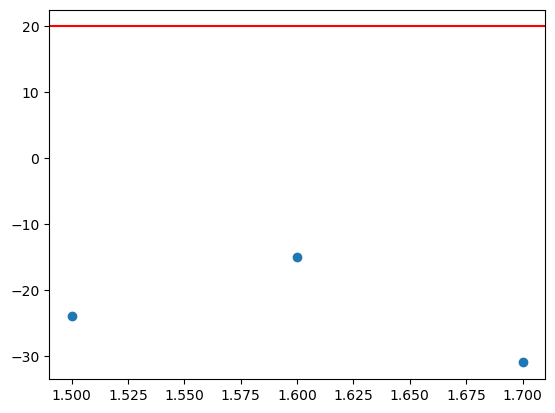

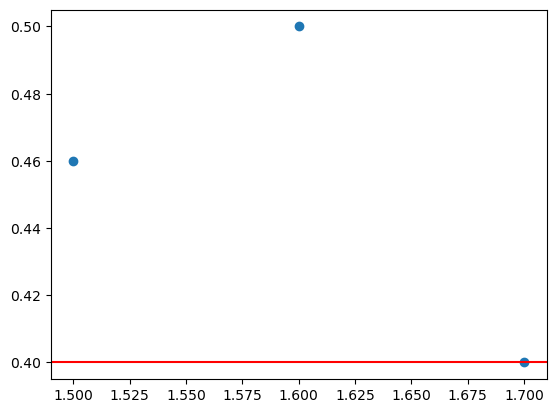

In [156]:
#Sims Graphs

dic = {}
tracker = []
rois = []
hits = []
bets = []

for i in range(0,41):
    ls = sim('casino',False,300,[8],   0.1,47,   (1.39+i*0.1),(2.01+i*0.1),   True,False,False,   False,True,False,False,False)
    if ls[2]>9:
        tracker.append(1.5+i*0.1)
        rois.append(ls[0])
        hits.append(ls[1])
        bets.append(ls[2])
        dic[1.5+i*0.1] = ls[2]
    else:
        break

f1 = plt.figure()
f2 = plt.figure()
g1 = f1.add_subplot(111)
g1.scatter(tracker,rois)
g1.axhline(y = 20, color = 'r', linestyle = '-')
g2 = f2.add_subplot(111)
g2.scatter(tracker,hits)
g2.axhline(y = 0.4, color = 'r', linestyle = '-')
plt.draw()
print(dic)

launceston 278 7 True counter: 6
{}
launceston 278 7 False counter: 6
{}
launceston 278 8 True counter: 6
{1.5: 22, 1.6: 23, 1.7: 23, 1.8: 21, 1.9: 20, 2.0: 16, 2.1: 14, 2.2: 15, 2.3: 13}
launceston 278 8 False counter: 6
{1.5: 18, 1.6: 19, 1.7: 21, 1.8: 27, 1.9: 27, 2.0: 26, 2.1: 22, 2.2: 21, 2.3: 19, 2.4: 20, 2.5: 21, 2.6: 14, 2.7: 16, 2.8: 13, 2.9000000000000004: 13}
cannington 275 7 True counter: 6
{}
cannington 275 7 False counter: 6
{}
cannington 275 8 True counter: 4
{1.5: 26, 1.6: 25, 1.7: 20, 1.8: 25, 1.9: 22, 2.0: 25, 2.1: 25, 2.2: 27, 2.3: 29, 2.4: 31, 2.5: 28, 2.6: 26, 2.7: 22, 2.8: 19, 2.9000000000000004: 19, 3.0: 16, 3.1: 17, 3.2: 19, 3.3: 17, 3.4000000000000004: 16, 3.5: 21, 3.6: 17, 3.7: 16}
cannington 275 8 False counter: 3
{1.5: 14, 1.6: 21, 1.7: 23, 1.8: 30, 1.9: 32, 2.0: 36, 2.1: 41, 2.2: 35, 2.3: 32, 2.4: 31, 2.5: 34, 2.6: 31, 2.7: 32, 2.8: 35, 2.9000000000000004: 36, 3.0: 45, 3.1: 42, 3.2: 44, 3.3: 45, 3.4000000000000004: 44, 3.5: 42, 3.6: 29, 3.7: 25, 3.800000000

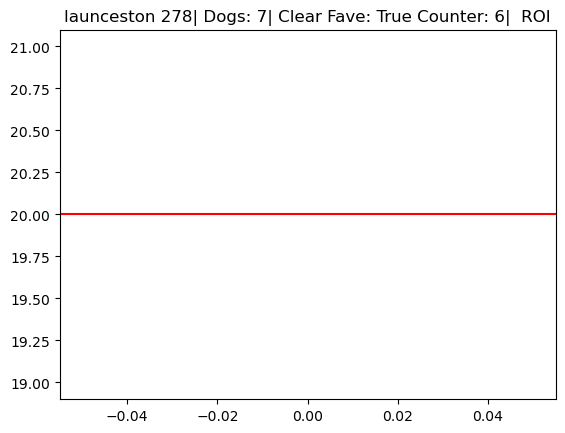

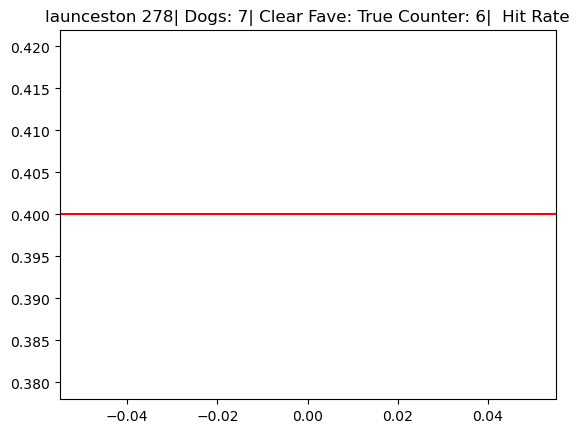

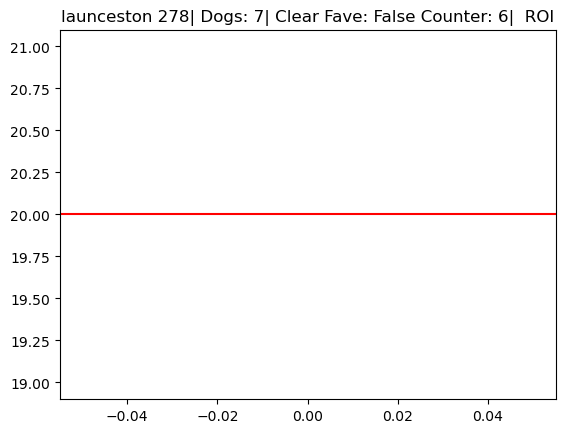

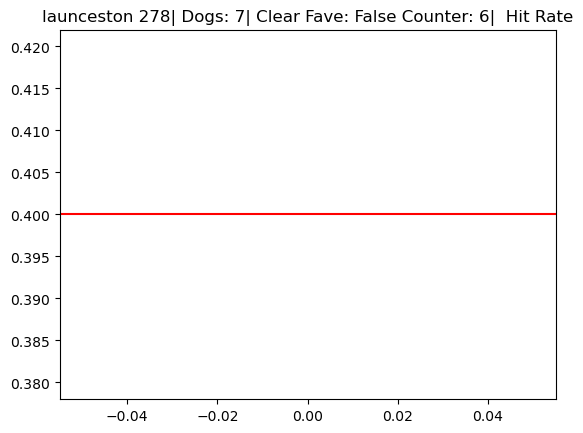

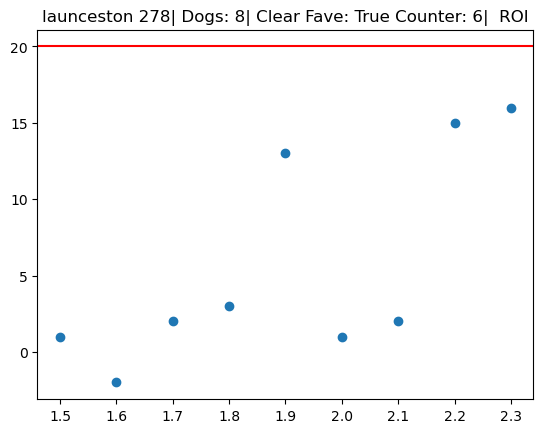

...

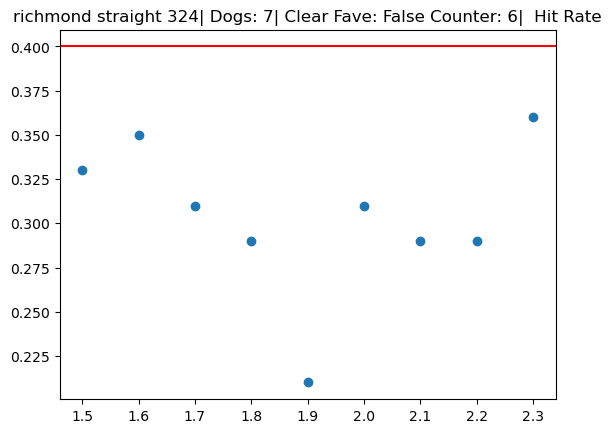

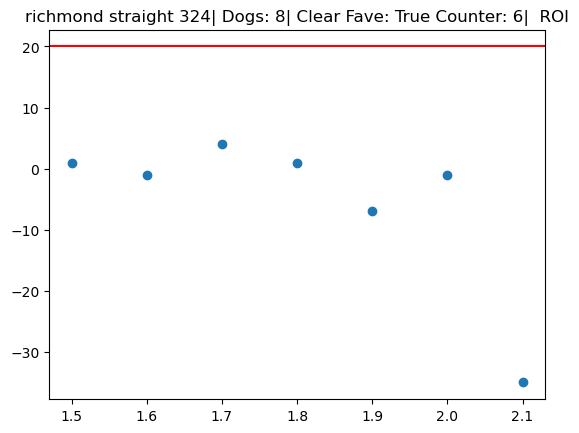

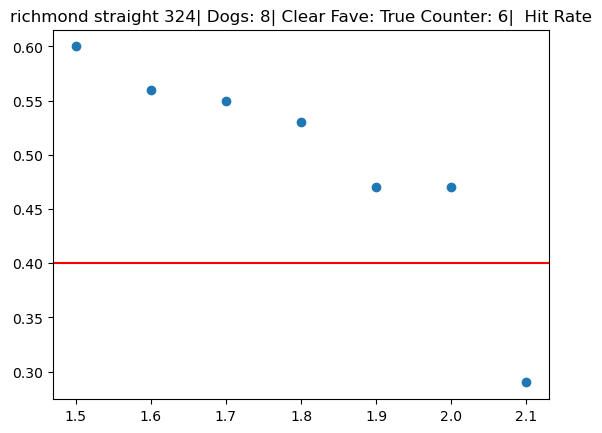

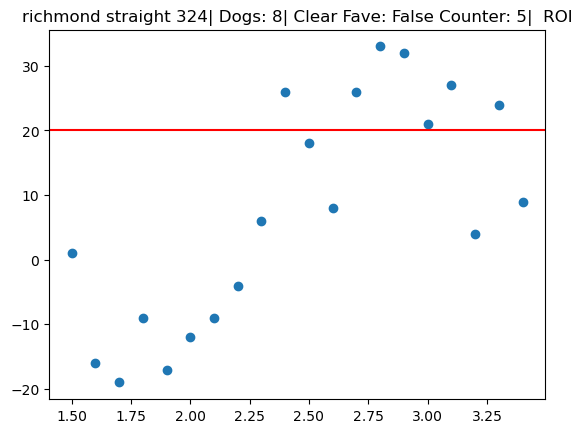

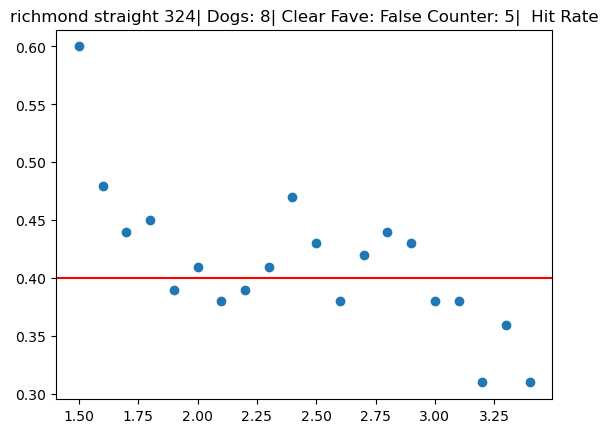

In [300]:
#Straight Preds

for x in dick1.keys():   
    for y in dick1[x]:
        for z in [7,8]:
            for q in [True,False]:
                try:
                    counter = 0
                    while counter <8:
                        dic = {}
                        tracker = []
                        rois = []
                        hits = []
                        bets = []

                        for i in range(0,41):
                            ls = sim(x,False,y,[z],   0.1,47,   (1.39+i*0.1),(counter/10+1.71+i*0.1),   q,False,False,   True,False,False,False,False)
                            if ls[2]>12:
                                tracker.append(1.5+i*0.1)
                                rois.append(ls[0])
                                hits.append(ls[1])
                                bets.append(ls[2])
                                dic[1.5+i*0.1] = ls[2]
                            else:
                                counter += 1
                                break
                        if len(rois)>19 or counter == 6: 
                            f1 = plt.figure()
                            f2 = plt.figure()
                            g1 = f1.add_subplot(111)
                            g1.scatter(tracker,rois)
                            g1.axhline(y = 20, color = 'r', linestyle = '-')
                            g2 = f2.add_subplot(111)
                            g2.scatter(tracker,hits)
                            g2.axhline(y = 0.4, color = 'r', linestyle = '-')
                            g1.title.set_text(x+' '+str(y)+'| Dogs: '+str(z)+'| Clear Fave: '+str(q)+' '+'Counter:'+' '+str(counter)+'| '+' ROI')
                            g2.title.set_text(x+' '+str(y)+'| Dogs: '+str(z)+'| Clear Fave: '+str(q)+' '+'Counter:'+' '+str(counter)+'| '+' Hit Rate')
                            plt.draw()
                            print(x,str(y),str(z),str(q),'counter:',str(counter))
                            print(dic)
                            break
                            
                except:
                    pass
        
plt.show()

bendigo 500 7 True counter: 6
{}
bendigo 500 7 False counter: 6
{}
bendigo 500 8 True counter: 6
{1.5: 22, 1.6: 19, 1.7: 20, 1.8: 18, 1.9: 20, 2.0: 20, 2.1: 21, 2.2: 20, 2.3: 17, 2.4: 17, 2.5: 15, 2.6: 13, 2.7: 14}
bendigo 500 8 False counter: 6
{1.5: 15, 1.6: 18, 1.7: 20, 1.8: 24, 1.9: 27, 2.0: 29, 2.1: 28, 2.2: 28, 2.3: 29, 2.4: 26, 2.5: 25, 2.6: 26, 2.7: 24, 2.8: 24, 2.9000000000000004: 22, 3.0: 25, 3.1: 25, 3.2: 23, 3.3: 24, 3.4000000000000004: 21, 3.5: 20, 3.6: 19, 3.7: 18, 3.8000000000000003: 19, 3.9000000000000004: 17, 4.0: 15, 4.1: 18, 4.2: 16, 4.300000000000001: 22, 4.4: 19, 4.5: 19, 4.6: 15, 4.7: 13, 4.800000000000001: 15, 4.9: 15}
bendigo 425 7 True counter: 6
{1.5: 16, 1.6: 14, 1.7: 14, 1.8: 14, 1.9: 13, 2.0: 13}
bendigo 425 7 False counter: 4
{1.5: 14, 1.6: 17, 1.7: 18, 1.8: 20, 1.9: 16, 2.0: 21, 2.1: 24, 2.2: 30, 2.3: 24, 2.4: 26, 2.5: 25, 2.6: 26, 2.7: 26, 2.8: 23, 2.9000000000000004: 17, 3.0: 20, 3.1: 18, 3.2: 19, 3.3: 21, 3.4000000000000004: 20, 3.5: 19, 3.6: 18, 3.7: 

ballarat 450 7 True counter: 6
{1.5: 13}
ballarat 450 7 False counter: 5
{1.5: 20, 1.6: 21, 1.7: 19, 1.8: 18, 1.9: 20, 2.0: 18, 2.1: 16, 2.2: 14, 2.3: 17, 2.4: 18, 2.5: 17, 2.6: 17, 2.7: 18, 2.8: 19, 2.9000000000000004: 21, 3.0: 22, 3.1: 19, 3.2: 17, 3.3: 16, 3.4000000000000004: 16, 3.5: 13}
ballarat 450 8 True counter: 6
{1.5: 26, 1.6: 24, 1.7: 25, 1.8: 23, 1.9: 23, 2.0: 16, 2.1: 17, 2.2: 15, 2.3: 16, 2.4: 17, 2.5: 18, 2.6: 16, 2.7: 18, 2.8: 18, 2.9000000000000004: 18, 3.0: 17, 3.1: 16, 3.2: 14}
ballarat 450 8 False counter: 5
{1.5: 16, 1.6: 14, 1.7: 14, 1.8: 17, 1.9: 20, 2.0: 19, 2.1: 21, 2.2: 23, 2.3: 26, 2.4: 26, 2.5: 25, 2.6: 23, 2.7: 23, 2.8: 26, 2.9000000000000004: 25, 3.0: 23, 3.1: 20, 3.2: 23, 3.3: 25, 3.4000000000000004: 26, 3.5: 22, 3.6: 25, 3.7: 23, 3.8000000000000003: 24, 3.9000000000000004: 24, 4.0: 24, 4.1: 18, 4.2: 21, 4.300000000000001: 21, 4.4: 21, 4.5: 21, 4.6: 19, 4.7: 17}
ballarat 390 7 True counter: 6
{1.5: 17, 1.6: 14, 1.7: 13, 1.8: 14}
ballarat 390 7 False count

cannington 520 7 True counter: 6
{1.5: 20, 1.6: 18, 1.7: 16, 1.8: 15}
cannington 520 7 False counter: 6
{}
cannington 520 8 True counter: 6
{1.5: 21, 1.6: 24, 1.7: 23, 1.8: 24, 1.9: 27, 2.0: 23, 2.1: 21, 2.2: 16, 2.3: 16, 2.4: 14, 2.5: 16, 2.6: 17, 2.7: 18, 2.8: 17, 2.9000000000000004: 18, 3.0: 18, 3.1: 16, 3.2: 15, 3.3: 13}
cannington 520 8 False counter: 5
{1.5: 14, 1.6: 19, 1.7: 17, 1.8: 15, 1.9: 16, 2.0: 19, 2.1: 18, 2.2: 18, 2.3: 16, 2.4: 14, 2.5: 14, 2.6: 19, 2.7: 17, 2.8: 15, 2.9000000000000004: 17, 3.0: 16, 3.1: 17, 3.2: 15, 3.3: 14, 3.4000000000000004: 14, 3.5: 14, 3.6: 16}
cannington 275 7 True counter: 6
{}
cannington 275 7 False counter: 6
{}
cannington 275 8 True counter: 5
{1.5: 20, 1.6: 26, 1.7: 29, 1.8: 29, 1.9: 32, 2.0: 34, 2.1: 31, 2.2: 35, 2.3: 31, 2.4: 24, 2.5: 22, 2.6: 21, 2.7: 19, 2.8: 17, 2.9000000000000004: 17, 3.0: 13, 3.1: 13, 3.2: 15, 3.3: 16, 3.4000000000000004: 18, 3.5: 15, 3.6: 18, 3.7: 17, 3.8000000000000003: 16, 3.9000000000000004: 15, 4.0: 15, 4.1: 13}


rockhampton 407 7 True counter: 6
{}
rockhampton 407 7 False counter: 6
{1.5: 14, 1.6: 19, 1.7: 19, 1.8: 21, 1.9: 20, 2.0: 20, 2.1: 21, 2.2: 24, 2.3: 21, 2.4: 18, 2.5: 19, 2.6: 15, 2.7: 14, 2.8: 13}
rockhampton 407 8 True counter: 5
{1.5: 17, 1.6: 18, 1.7: 15, 1.8: 18, 1.9: 18, 2.0: 20, 2.1: 20, 2.2: 24, 2.3: 26, 2.4: 27, 2.5: 28, 2.6: 24, 2.7: 22, 2.8: 20, 2.9000000000000004: 18, 3.0: 19, 3.1: 16, 3.2: 15, 3.3: 13, 3.4000000000000004: 17, 3.5: 17, 3.6: 19, 3.7: 17, 3.8000000000000003: 13, 3.9000000000000004: 13}
rockhampton 407 8 False counter: 2
{1.5: 16, 1.6: 17, 1.7: 18, 1.8: 15, 1.9: 14, 2.0: 16, 2.1: 18, 2.2: 21, 2.3: 33, 2.4: 36, 2.5: 31, 2.6: 32, 2.7: 32, 2.8: 22, 2.9000000000000004: 22, 3.0: 22, 3.1: 21, 3.2: 22, 3.3: 21, 3.4000000000000004: 19, 3.5: 17, 3.6: 16, 3.7: 14}
hobart 340 7 True counter: 6
{}
hobart 340 7 False counter: 6
{}
hobart 340 8 True counter: 6
{1.5: 17, 1.6: 17, 1.7: 15}
hobart 340 8 False counter: 6
{}
hobart 461 7 True counter: 6
{1.5: 19, 1.6: 14}
hobar

townsville 498 8 False counter: 6
{}
dubbo 318 7 True counter: 6
{}
dubbo 318 7 False counter: 6
{1.5: 15, 1.6: 16, 1.7: 15, 1.8: 13, 1.9: 17, 2.0: 19, 2.1: 19, 2.2: 20, 2.3: 20, 2.4: 20, 2.5: 18, 2.6: 17, 2.7: 17}
dubbo 318 8 True counter: 6
{1.5: 18, 1.6: 18, 1.7: 18, 1.8: 21, 1.9: 19, 2.0: 16, 2.1: 13}
dubbo 318 8 False counter: 6
{1.5: 14, 1.6: 16, 1.7: 17, 1.8: 15, 1.9: 18, 2.0: 17, 2.1: 16, 2.2: 15, 2.3: 16, 2.4: 21, 2.5: 20, 2.6: 20, 2.7: 22, 2.8: 21, 2.9000000000000004: 21, 3.0: 19, 3.1: 20, 3.2: 19, 3.3: 13}
dubbo 400 7 True counter: 6
{}
dubbo 400 7 False counter: 6
{}
dubbo 400 8 True counter: 6
{}
dubbo 400 8 False counter: 6
{}
capalaba 366 7 True counter: 6
{1.5: 19, 1.6: 14, 1.7: 17, 1.8: 15, 1.9: 13}
capalaba 366 7 False counter: 5
{1.5: 24, 1.6: 21, 1.7: 20, 1.8: 16, 1.9: 16, 2.0: 17, 2.1: 17, 2.2: 17, 2.3: 17, 2.4: 18, 2.5: 18, 2.6: 19, 2.7: 21, 2.8: 19, 2.9000000000000004: 18, 3.0: 18, 3.1: 18, 3.2: 19, 3.3: 18, 3.4000000000000004: 18, 3.5: 14, 3.6: 14}
capalaba 366 

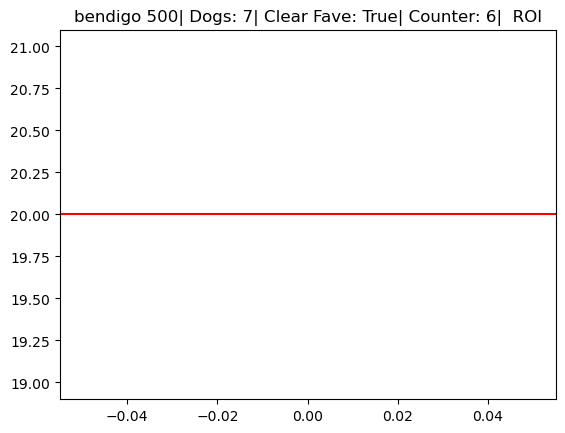

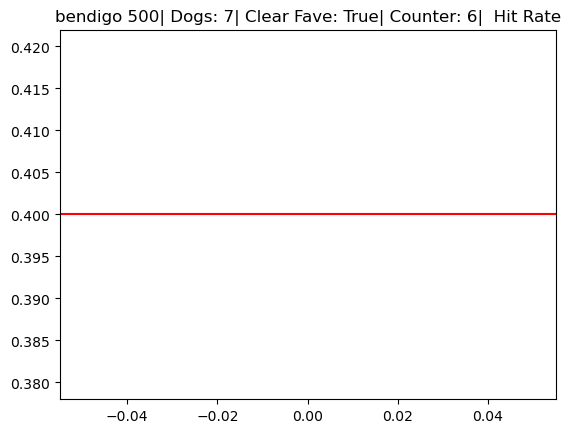

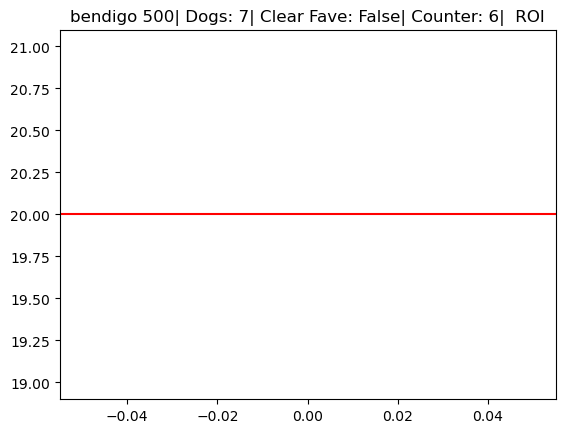

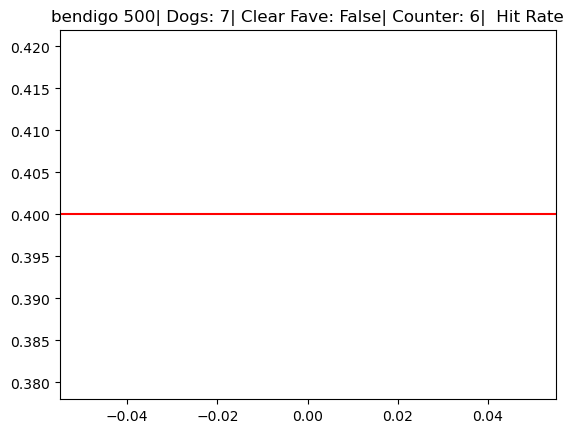

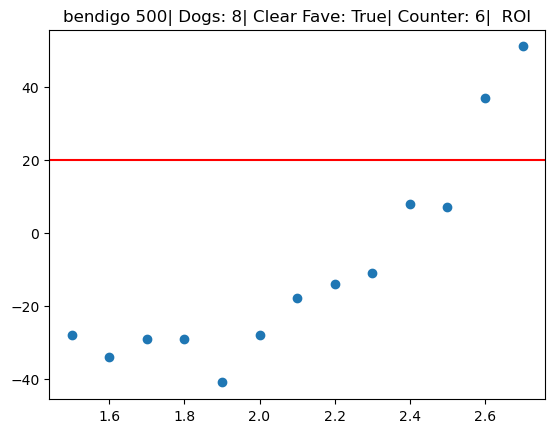

...

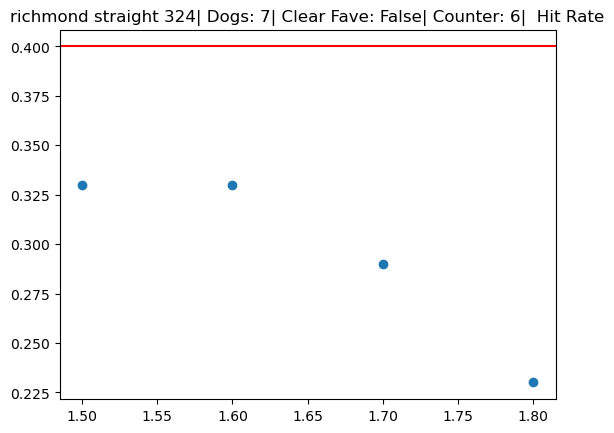

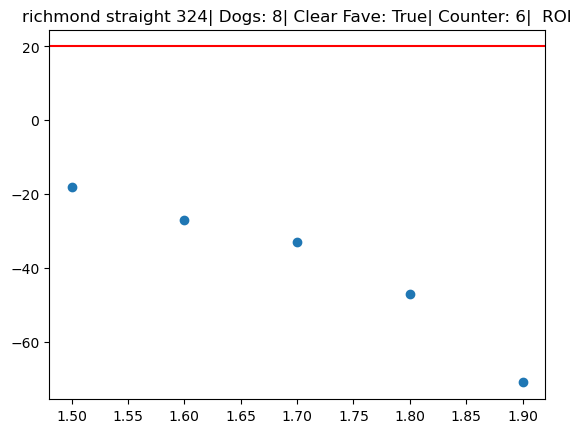

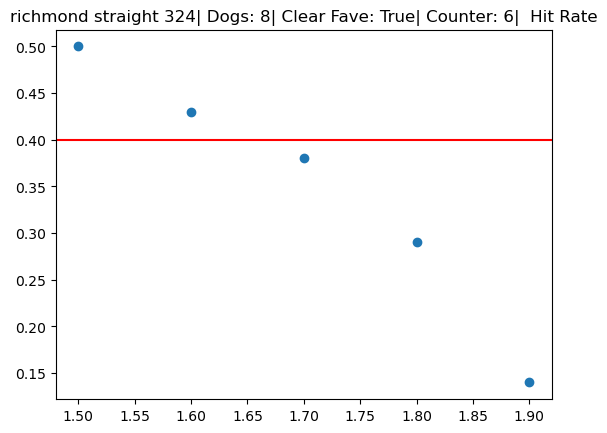

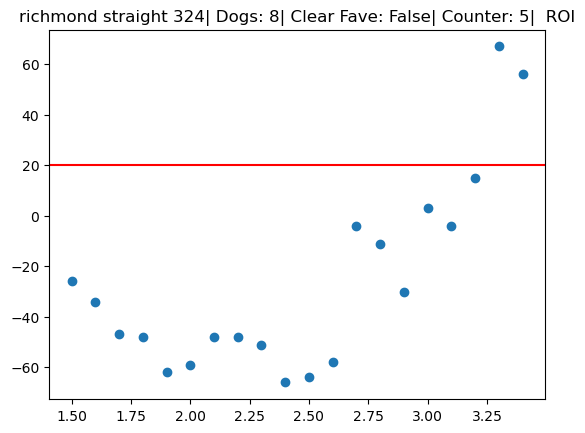

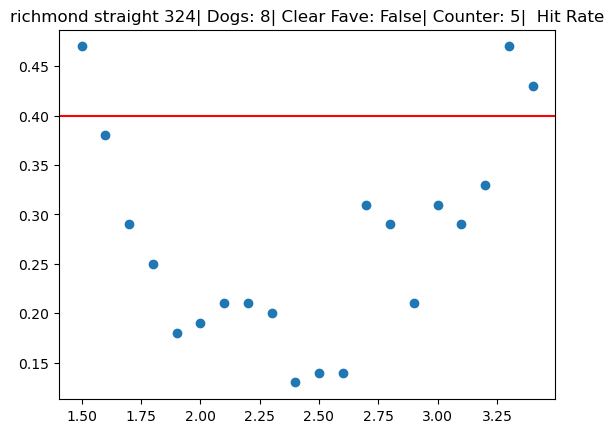

In [305]:
#320 Preds

for x in dick.keys():   
    for y in dick[x]:
        for z in [7,8]:
            for q in [True,False]:
                try:
                    counter = 0
                    while counter <8:
                        dic = {}
                        tracker = []
                        rois = []
                        hits = []
                        bets = []

                        for i in range(0,41):
                            ls = sim(x,False,y,[z],   0.1,47,   (1.39+i*0.1),(counter/10+1.71+i*0.1),   q,False,False,   False,True,False,False,False)
                            if ls[2]>12:
                                tracker.append(1.5+i*0.1)
                                rois.append(ls[0])
                                hits.append(ls[1])
                                bets.append(ls[2])
                                dic[1.5+i*0.1] = ls[2]
                            else:
                                counter += 1
                                break
                        if len(rois)>19 or counter == 6: 
                            f1 = plt.figure()
                            f2 = plt.figure()
                            g1 = f1.add_subplot(111)
                            g1.scatter(tracker,rois)
                            g1.axhline(y = 20, color = 'r', linestyle = '-')
                            g2 = f2.add_subplot(111)
                            g2.scatter(tracker,hits)
                            g2.axhline(y = 0.4, color = 'r', linestyle = '-')
                            g1.title.set_text(x+' '+str(y)+'| Dogs: '+str(z)+'| Clear Fave: '+str(q)+'| '+'Counter:'+' '+str(counter)+'| '+' ROI')
                            g2.title.set_text(x+' '+str(y)+'| Dogs: '+str(z)+'| Clear Fave: '+str(q)+'| '+'Counter:'+' '+str(counter)+'| '+' Hit Rate')
                            plt.draw()
                            print(x,str(y),str(z),str(q),'counter:',str(counter))
                            print(dic)
                            break
                            
                except:
                    pass
        
plt.show()

bendigo 500 7 True counter: 6
{1.5: 14, 1.6: 13}
bendigo 500 7 False counter: 6
{}
bendigo 500 8 True counter: 6
{1.5: 20, 1.6: 19, 1.7: 19, 1.8: 18, 1.9: 16, 2.0: 19, 2.1: 20, 2.2: 18, 2.3: 17, 2.4: 16, 2.5: 15, 2.6: 13, 2.7: 13, 2.8: 13}
bendigo 500 8 False counter: 5
{1.5: 15, 1.6: 20, 1.7: 17, 1.8: 20, 1.9: 22, 2.0: 27, 2.1: 30, 2.2: 29, 2.3: 23, 2.4: 26, 2.5: 28, 2.6: 27, 2.7: 27, 2.8: 23, 2.9000000000000004: 22, 3.0: 20, 3.1: 23, 3.2: 17, 3.3: 13, 3.4000000000000004: 13}
sandown park 515 7 True counter: 6
{1.5: 25, 1.6: 21, 1.7: 20, 1.8: 18, 1.9: 17, 2.0: 18, 2.1: 17, 2.2: 18, 2.3: 17, 2.4: 16, 2.5: 16, 2.6: 15, 2.7: 17, 2.8: 16, 2.9000000000000004: 15, 3.0: 14}
sandown park 515 7 False counter: 5
{1.5: 21, 1.6: 24, 1.7: 27, 1.8: 30, 1.9: 33, 2.0: 33, 2.1: 32, 2.2: 30, 2.3: 30, 2.4: 26, 2.5: 20, 2.6: 15, 2.7: 16, 2.8: 20, 2.9000000000000004: 18, 3.0: 21, 3.1: 24, 3.2: 28, 3.3: 29, 3.4000000000000004: 28, 3.5: 26, 3.6: 24, 3.7: 22, 3.8000000000000003: 20, 3.9000000000000004: 16}
s

the meadows 600 7 True counter: 6
{}
the meadows 600 7 False counter: 6
{}
the meadows 600 8 True counter: 6
{1.5: 14, 1.6: 15, 1.7: 16, 1.8: 17, 1.9: 18, 2.0: 18, 2.1: 15, 2.2: 14, 2.3: 13}
the meadows 600 8 False counter: 6
{}
wentworth park 520 7 True counter: 4
{1.5: 40, 1.6: 30, 1.7: 32, 1.8: 31, 1.9: 27, 2.0: 30, 2.1: 27, 2.2: 33, 2.3: 31, 2.4: 29, 2.5: 26, 2.6: 30, 2.7: 25, 2.8: 25, 2.9000000000000004: 19, 3.0: 17, 3.1: 18, 3.2: 17, 3.3: 16, 3.4000000000000004: 17, 3.5: 13}
wentworth park 520 7 False counter: 2
{1.5: 16, 1.6: 16, 1.7: 17, 1.8: 15, 1.9: 14, 2.0: 14, 2.1: 19, 2.2: 26, 2.3: 27, 2.4: 24, 2.5: 22, 2.6: 18, 2.7: 13, 2.8: 15, 2.9000000000000004: 17, 3.0: 18, 3.1: 20, 3.2: 19, 3.3: 19, 3.4000000000000004: 15, 3.5: 15, 3.6: 14, 3.7: 14}
wentworth park 520 8 True counter: 2
{1.5: 40, 1.6: 38, 1.7: 34, 1.8: 34, 1.9: 26, 2.0: 25, 2.1: 22, 2.2: 25, 2.3: 24, 2.4: 18, 2.5: 21, 2.6: 14, 2.7: 16, 2.8: 16, 2.9000000000000004: 16, 3.0: 14, 3.1: 17, 3.2: 17, 3.3: 15, 3.400000000000

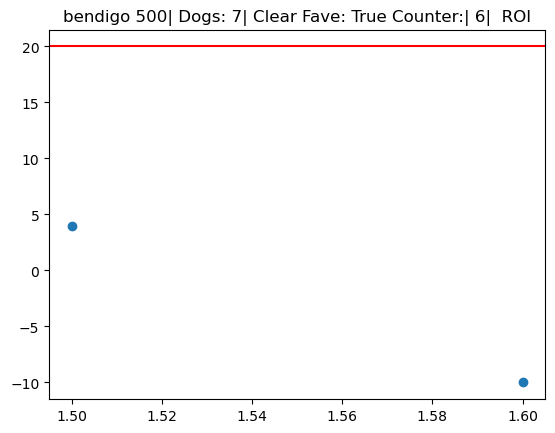

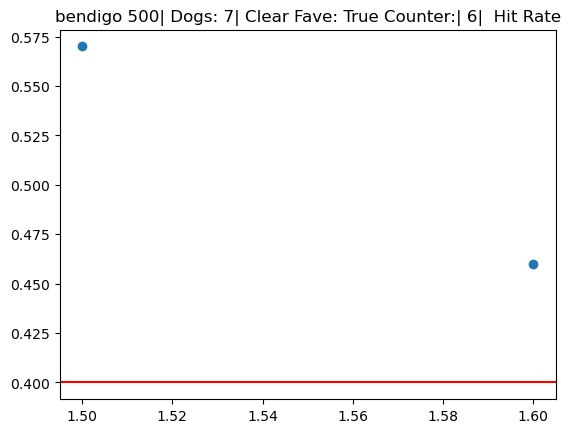

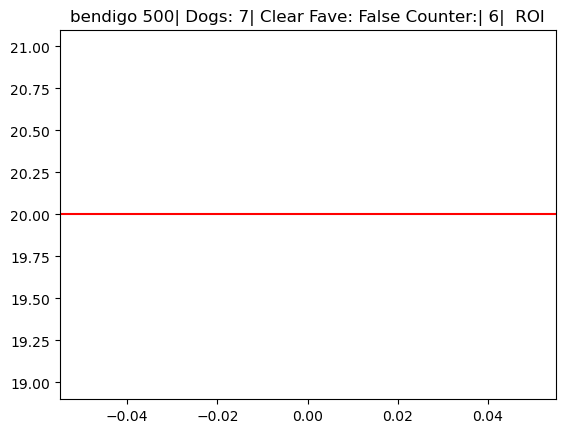

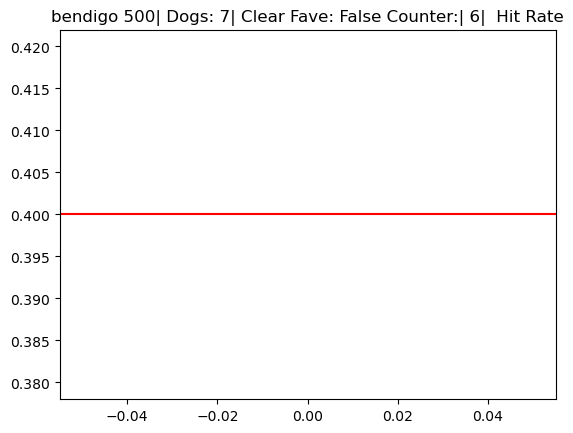

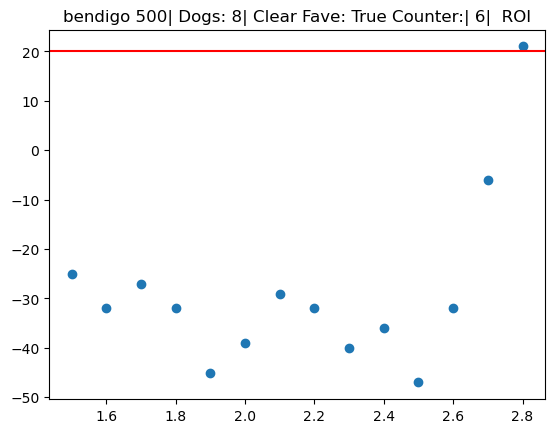

...

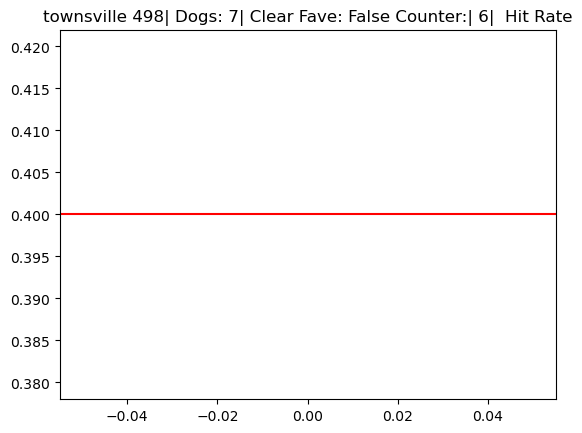

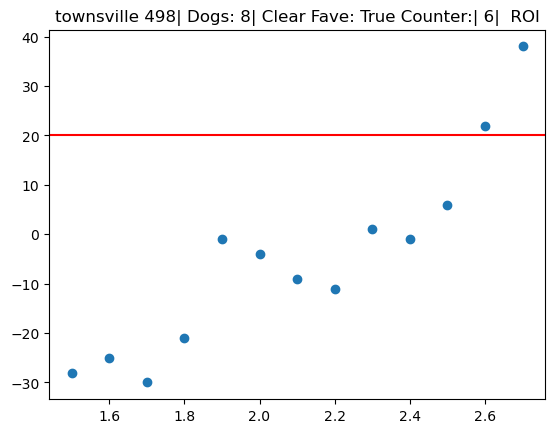

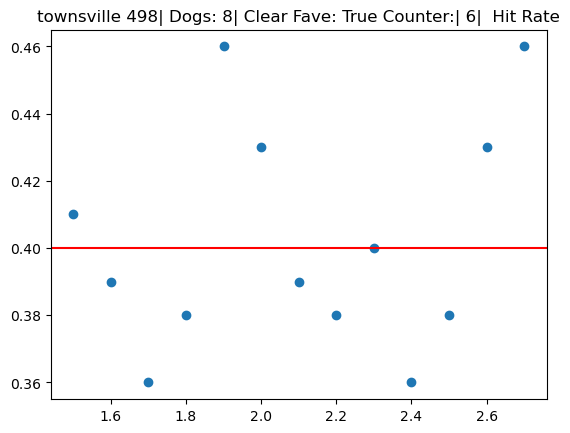

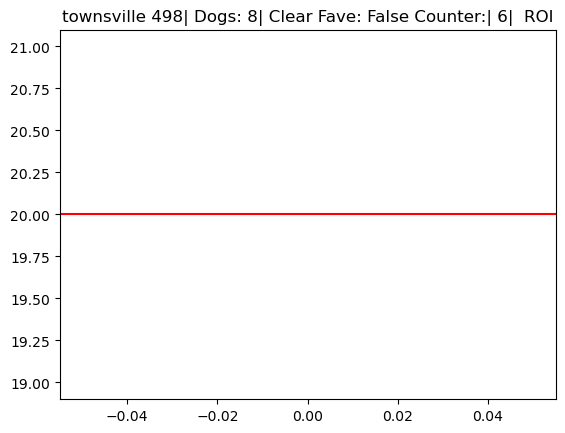

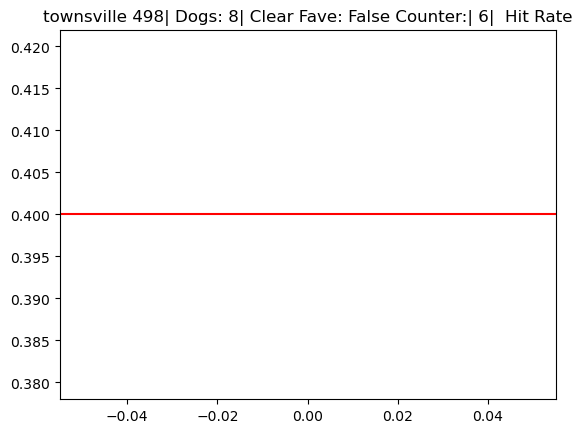

In [307]:
#520 Preds

for x in dick2.keys():   
    for y in dick2[x]:
        for z in [7,8]:
            for q in [True,False]:
                try:
                    counter = 0
                    while counter <8:
                        dic = {}
                        tracker = []
                        rois = []
                        hits = []
                        bets = []

                        for i in range(0,41):
                            ls = sim(x,False,y,[z],   0.1,47,   (1.39+i*0.1),(counter/10+1.71+i*0.1),   q,False,False,   False,False,False,True,False)
                            if ls[2]>12:
                                tracker.append(1.5+i*0.1)
                                rois.append(ls[0])
                                hits.append(ls[1])
                                bets.append(ls[2])
                                dic[1.5+i*0.1] = ls[2]
                            else:
                                counter += 1
                                break
                        if len(rois)>19 or counter == 6: 
                            f1 = plt.figure()
                            f2 = plt.figure()
                            g1 = f1.add_subplot(111)
                            g1.scatter(tracker,rois)
                            g1.axhline(y = 20, color = 'r', linestyle = '-')
                            g2 = f2.add_subplot(111)
                            g2.scatter(tracker,hits)
                            g2.axhline(y = 0.4, color = 'r', linestyle = '-')
                            g1.title.set_text(x+' '+str(y)+'| Dogs: '+str(z)+'| Clear Fave: '+str(q)+' '+'Counter:'+'| '+str(counter)+'| '+' ROI')
                            g2.title.set_text(x+' '+str(y)+'| Dogs: '+str(z)+'| Clear Fave: '+str(q)+' '+'Counter:'+'| '+str(counter)+'| '+' Hit Rate')
                            plt.draw()
                            print(x,str(y),str(z),str(q),'counter:',str(counter))
                            print(dic)
                            break
                            
                except:
                    pass
        
plt.show()

In [ ]:
dick = {'bendigo': [500, 425],
 'sandown park': [515, 595],
 'sale': [440],
 'albion park': [331, 395, 520],
 'mount gambier': [512, 400],
 'angle park': [515, 342],
 'shepparton': [390, 450],
 'traralgon': [395, 450],
 'ballarat': [450, 390],
 'nowra': [365],
 'launceston': [515, 278],
 'grafton': [350],
 'warragul': [460, 400],
 'horsham': [410, 485],
 'geelong': [460, 400],
 'cannington': [380, 520, 275],
 'maitland': [400],
 'ipswich': [431, 520, 288],
 'the meadows': [525, 600],
 'darwin': [312, 383],
 'richmond': [401, 320],
 'wentworth park': [520],
 'rockhampton': [407],
 'hobart': [340, 461],
 'casino': [411, 300],
 'goulburn': [350, 440],
 'dapto': [520, 297],
 'healesville': [300, 350],
 'the gardens': [515, 400, 272],
 'wagga': [320],
 'bulli': [400],
 'bundaberg': [460],
 'gawler': [400, 531],
 'townsville': [380, 498],
 'dubbo': [318, 400],
 'temora': [330],
 'capalaba': [366],
 'warrnambool': [390, 450],
 'gosford': [388],
 'murray bridge': [395, 300],
 'gunnedah': [340],
 'richmond straight': [324]}

dick1 = {'launceston': [278],
 'cannington': [275],
 'ipswich': [288],
 'dapto': [297],
 'healesville': [300, 350],
 'the gardens': [272],
 'capalaba': [366],
 'murray bridge': [300],
 'richmond straight': [324]}

dick2 = {'bendigo': [500],
 'sandown park': [515, 595],
 'albion park': [520],
 'mount gambier': [512],
 'angle park': [515],
 'shepparton': [450],
 'ballarat': [450],
 'launceston': [515],
 'warragul': [460],
 'horsham': [485],
 'cannington': [520],
 'ipswich': [520],
 'the meadows': [525, 600],
 'wentworth park': [520],
 'goulburn': [440],
 'dapto': [520],
 'the gardens': [515],
 'bundaberg': [460],
 'gawler': [531],
 'townsville': [498]}